# Solving structures with the GALLOP Python API - basic use
> A walkthrough for using the GALLOP Python API to solve the crystal structures of small molecules

- toc: true
- badges: true
- comments: true
- categories: [GALLOP, PXRD, Python]
- author: Mark Spillman
- image: images/kde_header.png

## Introduction

In my [previous post](https://mspillman.github.io/blog/gallop/pxrd/python/2021/11/02/Solving-structures-with-GALLOP-browser-interface.html), I went over how to use the *GALLOP* browser interface to solve the crystal structure of verapamil hydrochloride.

In this post, I'll go over the basic way to use *GALLOP* Python API to solve the crystal structure of verapamil hydrochloride. The complete set of fit files I'll be using are available as a zip archive you can download [here](https://github.com/mspillman/blog/blob/master/_notebooks/files/verapamil_hydrochloride.zip).

In a future post, I'll look at more sophisticated ways of using the *GALLOP* Python API to customise the optimisaition procedure.

## Install GALLOP and import libraries

This cell is only needed if you are going to run this blog via colab - it will install gallop onto the colab virtual machine.

In [1]:
#uncomment to download and install GALLOP if running on Colab
#!git clone https://github.com/mspillman/gallop.git && cd gallop && pip install .

Let's now import the libraries we'll need for our initial solution of verapamil hydrochloride.

In [1]:
import time
import numpy as np
import matplotlib.pyplot as plt
from gallop.structure import Structure
from gallop.optim import local
from gallop.optim import Swarm

## Create a Structure object and add the data to it

Our next job is to create a *GALLOP* structure object. The Structure class is used to store all of the information needed for the local optimisation procedure. We can specify a name for the Structure here, which will be used for any files we write out later (e.g. CIFs. We can also set the parameter that tells GALLOP to ignore the positions of hydrogen atoms during local optimisation. This significantly increases both the speed and the total number of particles that can be simulataneously evaluated, so only set this to False if you really need to!

In [2]:
mystructure = Structure(name="VerapamilHCl", ignore_H_atoms=True)

Next up, we should add some diffraction data to our Structure object.

Currently, *GALLOP* accepts data that has been fitted by *DASH*, *GSAS-II* and *TOPAS*. In the future, I'm planning to add the ability to include *SHELX*-style data which may be of interest for those working with high-pressure single crystal diffraction data.

We need to tell the Structure object what program was used to fit the diffraction data so it knows what to look for:
 - If using diffraction data fitted by *DASH*, then we supply the filename for the ```.sdi``` and indicate that the source of the data is *DASH*
 - If using diffraction data fitted by *GSAS-II*, then we supply the filename for the ```.gpx``` and indicate that the source of the data is *GSAS-II*
 - If using diffraction data fitted by *TOPAS*, then we supply the filename for the ```.out``` and indicate that the source of the data is *TOPAS*

We can check that the data have been read in correctly by printing out the unit cell parameters and the first few peak intensities.

In [3]:
mystructure.add_data("files/Verap.sdi", source="DASH")

print("Unit cell:", mystructure.unit_cell)
print("Intensities 1-5:",mystructure.intensities[:5])

Unit cell: [  7.08991  10.59464  19.20684 100.1068   93.7396  101.561  ]
Intensities 1-5: [ 85.705 235.032   0.614  -6.39  225.05 ]


Next we need to add the Z-matrices to the structure object. The Z-matrices are expected to be in the format used by *DASH*. For more information on this format, see [here](https://github.com/mspillman/gallop#z-matrices).

This will automatically print out some information about the Z-matrices by default, though you can supply the argument ```verbose=False``` if you'd like to suppress that.

In [4]:
mystructure.add_zmatrix("files/CURHOM_1.zmatrix")
mystructure.add_zmatrix("files/CURHOM_2.zmatrix")

Added Z-matrix with Filename: files/CURHOM_1.zmatrix
Non-H atoms: 1
Refineable torsions: 0
Degrees of freedom: 3
Added Z-matrix with Filename: files/CURHOM_2.zmatrix
Non-H atoms: 33
Refineable torsions: 13
Degrees of freedom: 20 (7 + 13)


## Initialise a Particle Swarm

Next thing we'll need is a Particle Swarm optimiser. To do this, we initialise a Swarm object, and then use it to generate the initial external and internal degrees of freedom for our structure.

We need to specify the total number of particles, and how many swarms these should be divided into. Verapamil hydrochloride is relatively simple for GALLOP, so let's go for 10,000 particles split into 10 swarms (i.e. 1000 particles per swarm).

In [5]:
swarm = Swarm(mystructure, n_particles=10000, n_swarms=10)

Now let's use the swarm to generate the initial external and internal degrees of freedom. By default, this will use [Latin hypercube sampling](https://en.wikipedia.org/wiki/Latin_hypercube_sampling) rather than uniform sampling as it gives a more even coverage of the hypersurface. If you want to use uniform sampling you can supply the argument ```method="uniform"``` to the function below.

We can also include Mogul Distribution Bias information to this function if available, which will bias the initial torsion angles to match the distribution obtained in the CSD. This is accomplished by using *DASH* to create a DASH batch file (```.dbf```) which we supply as an additional argument, ```MDB="filename.dbf"```.

In [6]:
external, internal = swarm.get_initial_positions(method="latin", MDB=None)

Total degrees of freedom: 23
Total external degrees of freedom: 10 (pos: 6 rot: 4 )
Total internal degrees of freedom: 13


100%|██████████| 10/10 [00:00<00:00, 667.17it/s]


The degrees of freedom are organised as follows:
- External:
    1. Position (x,y,z) for ZM 1 - N
    2. Quaternions (q1,q2,q3,q4) for ZM 1 - N
- Internal:
    1. Torsion (t1,...,tn) for ZM 1 - N

So for verapamil hydrochloride, we have the following structure to the external DoFs:
$$[x_{Cl},y_{Cl},z_{Cl},x_{V},y_{V},z_{V},q1_{V},q2_{V},q3_{V},q4_{V}]$$

Only the verapamil Z-matrix has any torsion angles, so all DoFs in the internal array correspond to verapamil torsons.

Let's plot a couple of these DoFs to ensure we have the expected even distribution. Positions are generated in the range [0,1]. Quaternions are generated in the range [-1,1] and torsions are generated in the range [$-\pi$, $\pi$]. This is particularly useful if we are using MDB to ensure the resultant distribution matches that expected.

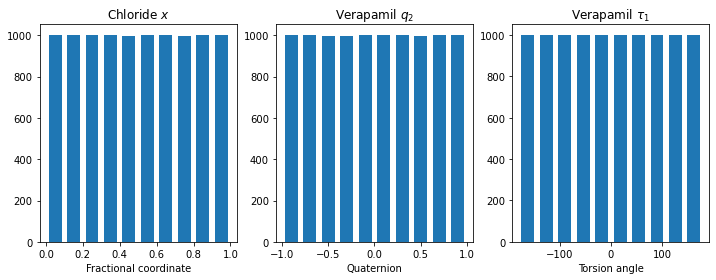

In [7]:
#collapse-hide
fig, ax = plt.subplots(1,3, figsize=(12,4))

ax[0].hist(external[:,0], rwidth=0.7)
ax[0].set_title("Chloride $x$")
ax[0].set_xlabel("Fractional coordinate")

ax[1].hist(external[:,7], rwidth=0.7)
ax[1].set_title("Verapamil $q_2$")
ax[1].set_xlabel("Quaternion")

ax[2].hist(np.rad2deg(internal[:,0]), rwidth=0.7)
ax[2].set_title("Verapamil $\\tau_1$")
ax[2].set_xlabel("Torsion angle")
plt.show()

These are reassuringly boring plots!

## Set up the run parameters and find the learning rate

The next thing we'll need to do is set up the parameters we want to use for the runs (i.e. number of iterations etc) and also (optionally) use the learning rate finder to come up with a *reasonable* first attempt learning rate for this structure.

First thing we'll do is automatically generate a settings dictionary, and then modify those settings if desired. We'll print out the keys for the dictionary and see if anything needs changing.

In [8]:
minimiser_settings = local.get_minimiser_settings(mystructure)

print(minimiser_settings.keys())

dict_keys(['n_reflections', 'include_dw_factors', 'chi2_solved', 'n_iterations', 'n_cooldown', 'learning_rate', 'learning_rate_schedule', 'verbose', 'use_progress_bar', 'print_every', 'check_min', 'dtype', 'device', 'optimizer', 'loss', 'eps', 'save_CIF', 'streamlit', 'torsion_shadowing', 'Z_prime', 'use_restraints', 'include_PO', 'PO_axis'])


Most of these should be fine left at their default values. In some cases, you may wish to try solving with fewer reflections than are available in your dataset (perhaps in order to reduce GPU memory use). In such a scenario, you can set the number of reflections to use by modifying the 'n_reflections' dictionary value. You can find out about what the other parameters do in the docstring for the gallop.optim.local.minimise() function.

Here, we'll stick with the default values, which will use all reflections available in the data, the Adam optimiser, will run for 500 local optimisation iterations and will automatically save a CIF of the best structure found after each iteration.

Our next task will be to find a reasonable learning rate using the learning rate finder. Here we set ```multiplication_factor=None``` so it is calculated for us (as discussed below).

GALLOP iter 0000 LO iter 0200 min chi2 631.9: 100%|██████████| 200/200 [00:13<00:00, 15.06it/s]


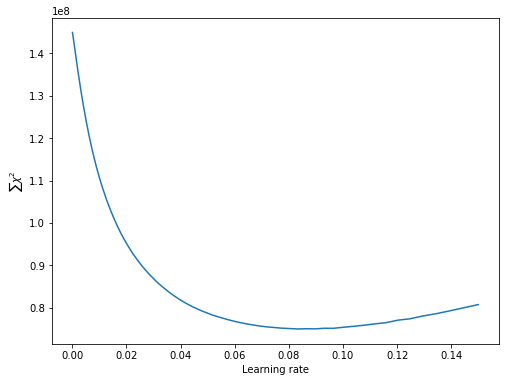

In [15]:
learning_rate = local.find_learning_rate(mystructure, external=external,
                internal=internal, minimiser_settings=minimiser_settings,
                multiplication_factor=None)

plt.figure(figsize=(8,6))
plt.plot(learning_rate[0], learning_rate[1])
plt.xlabel("Learning rate")
plt.ylabel("$\\sum{\\chi^2}$")
plt.show()

As discussed in my [introduction to GALLOP](https://mspillman.github.io/blog/gallop/pxrd/python/2021/10/30/Introduction-to-GALLOP.html#Learning-rate-finder) post, we will derive the learning rate from the minimum point on this curve. The learning_rate result obtained above is a list, which contains the following entries:
1. Trial learning rate values (x-axis)
2. Losses (y-axis)
3. The multiplication factor which scales the best learning rate found
4. The scaled learning rate - we can use this directly, by setting:
```python
minimiser_settings["learning_rate"] = learning_rate[3]
```

However, let's do the scaling process ourselves to see what it looks like.

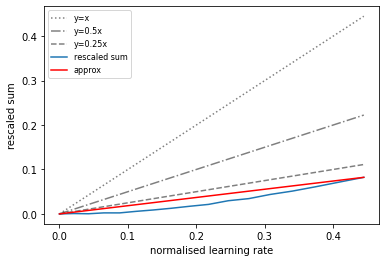

In [16]:
#collapse-hide
lrs = learning_rate[0].copy()
losses = learning_rate[1].copy()
multiplication_factor = learning_rate[2]
learning_rate_to_use = learning_rate[3]

lrs -= lrs.min()
lrs /= lrs.max()

losses -= losses.min()
losses /= losses.max()

minpoint = np.argmin(losses)

plt.plot(lrs[minpoint:]-lrs[minpoint:].min(),
    lrs[minpoint:]-lrs[minpoint:].min(),":",alpha=0.5,c="k")
plt.plot(lrs[minpoint:]-lrs[minpoint:].min(),
    0.5*(lrs[minpoint:]-lrs[minpoint:].min()),"-.",
    alpha=0.5,c="k")
plt.plot(lrs[minpoint:]-lrs[minpoint:].min(),
    0.25*(lrs[minpoint:]-lrs[minpoint:].min()),"--",
    alpha=0.5,c="k")
plt.plot(lrs[minpoint:]-lrs[minpoint:].min(),
                            losses[minpoint:])
gradient = ((losses[-1] - losses[minpoint])
            / (lrs[-1] - lrs[minpoint]))
plt.plot(lrs[minpoint:]-lrs[minpoint:].min(),
            gradient*(lrs[minpoint:]-lrs[minpoint:].min()),
            c="r")
plt.xlabel('normalised learning rate')
plt.ylabel('rescaled sum')
plt.legend(["y=x","y=0.5x","y=0.25x","rescaled sum", "approx"],
                loc=2, prop={'size': 8})

plt.show()

As can be seen, the gradient of the red line approximating the blue curve is fairly shallow - less than 0.25. As a result, this tells us that this particular structure is relatively insensitive to the learning rate, so we can use a relatively large learning rate and still expect good performance.

Therefore, we use a multiplication factor to 1.0, meaning that our learning rate will be $1.0 \times \alpha_{min}$ where $\alpha_{min}$ is the learning rate corresponding to the minimum point on the curve in the previous plot.

In [17]:
best_learning_rate = learning_rate[0][minpoint]

minimiser_settings["learning_rate"] = best_learning_rate

## Running *GALLOP*

We've now got everything we need sorted, all we need to do is write a very simple loop that will perform the *GALLOP* iterations.

The ```local.minimise()``` function returns a dictionary with keys ```external, internal, chi_2``` and potentially others depending on arguments supplied. These results are read in by the Swarm object and used to generate a new set of external and internal degrees of freedom.

Let's have a go at running *GALLOP* for 10 iterations.

In [18]:
# We'll get the time before the runs start so we have an indication of how long things have taken
start_time = time.time()

# Now we have the GALLOP loop
for i in range(10):
    # First do the local optimisation - notice the **minimiser_settings argument
    # which takes in the dictionary we created earlier
    result = local.minimise(mystructure, external=external, internal=internal,
                run=i, start_time=start_time, **minimiser_settings)

    # Particle swarm update generates new positions to be optimised
    external, internal = swarm.update_position(result=result)

GALLOP iter 0010 LO iter 0500 min chi2 56.2: 100%|██████████| 500/500 [00:34<00:00, 14.61it/s]


## Analysing the results

Let's re-plot the same histograms we made earlier and see how much things have changed. We'll plot the output directly from the local optimiser as well as the suggested next positions given by the particle swarm that would be used if we were running an additional *GALLOP* iteration. We'll also print out how many swarms reached a solution.

Number of swarms that solved the structure: 2


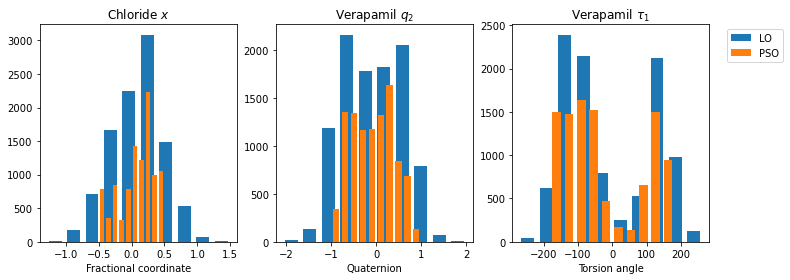

In [19]:
#collapse-hide
swarm_best_chi2 = np.array(swarm.best_subswarm_chi2)
print("Number of swarms that solved the structure:", (swarm_best_chi2 < 60).sum())

fig, ax = plt.subplots(1,3, figsize=(12,4))

ax[0].hist(result["external"][:,0], rwidth=0.7)
ax[0].hist(external[:,0], rwidth=0.7)
ax[0].set_title("Chloride $x$")
ax[0].set_xlabel("Fractional coordinate")

ax[1].hist(result["external"][:,7], rwidth=0.7)
ax[1].hist(external[:,7], rwidth=0.7)
ax[1].set_title("Verapamil $q_2$")
ax[1].set_xlabel("Quaternion")

ax[2].hist(np.rad2deg(result["internal"][:,0]), rwidth=0.7)
ax[2].hist(np.rad2deg(internal[:,0]), rwidth=0.7)
ax[2].set_title("Verapamil $\\tau_1$")
ax[2].set_xlabel("Torsion angle")

plt.legend(["LO","PSO"], loc="upper right", bbox_to_anchor=(1.4,1))
plt.show()

Unsurprisingly, these distributions have changed thanks to the optimisation. Also note that some of the blue bars sit outside the range of the orange bars - this is because the local optimiser is unbounded whereas the PSO is set to produce starting points within specified ranges.

We'll look at the distributions in more detail in a minute, however, let's first take a look at the structure. We can read over the CIFs of the best structure found after each iteration, and then pick one of these to visualise.

In [20]:
import glob

cifs = glob.glob(mystructure.name+"*.cif")
for i, fn in enumerate(cifs):
    print(i+1, fn)

1 VerapamilHCl_0001_406.121_chisqd_252_refs_0.6_mins.cif
2 VerapamilHCl_0002_396.857_chisqd_252_refs_1.1_mins.cif
3 VerapamilHCl_0003_310.273_chisqd_252_refs_1.7_mins.cif
4 VerapamilHCl_0004_56.491_chisqd_252_refs_2.3_mins.cif
5 VerapamilHCl_0005_56.247_chisqd_252_refs_2.8_mins.cif
6 VerapamilHCl_0006_56.245_chisqd_252_refs_3.4_mins.cif
7 VerapamilHCl_0007_56.244_chisqd_252_refs_4.0_mins.cif
8 VerapamilHCl_0008_56.244_chisqd_252_refs_4.6_mins.cif
9 VerapamilHCl_0009_56.244_chisqd_252_refs_5.1_mins.cif
10 VerapamilHCl_0010_56.244_chisqd_252_refs_5.7_mins.cif


Let's visualise the first solution with $\chi^2 < 60$, which was obtained after iteration 4.

In [21]:
#collapse-hide
import py3Dmol
from IPython.display import HTML
hide_H = True

structure_to_display = 1
print(cifs[structure_to_display-1])
with open(cifs[structure_to_display-1], "r") as cif:
        lines = []
        for line in cif:
            if hide_H:
                splitline = list(filter(
                        None,line.strip().split(" ")))
                if splitline[0] != "H":
                    lines.append(line)
            else:
                lines.append(line)
cif.close()
cif = "\n".join(lines)
view = py3Dmol.view()
view.addModel(cif, "cif",
    {"doAssembly" : True,
    "normalizeAssembly":True,
    'duplicateAssemblyAtoms':True})
view.setStyle({'sphere':{"scale":0.15},
                'stick':{"radius":0.25}})
view.addUnitCell()
view.zoomTo()
view.render()
HTML(view.startjs + "\n" + view.endjs + "\n")

VerapamilHCl_0001_406.121_chisqd_252_refs_0.6_mins.cif


Finally, let's try and get a feel for how the optimised positions of the particles are distributed. The interactive plot below allows you to explore the distribution of optimised positions for each combination of the degrees of freedom. As you can see, the optimised particles tend to cluster around specific combinations of values - this isn't too surprising. Once a swarm has located the global minimum, all of the other particles in the swarm will begin to move in that direction causing large numbers of particles to have very similar degrees of freedom after a few additional iterations.

Note that due to a quirk of the library I'm using to generate the plots and interactive widget, the first plot you see is the x-coordinate of the chloride ion plotted against itself. This effectively gives a diagonal line which is equivalent to a histogram of the chloride x-coordinate distribution.

In [22]:
#collapse-hide
import pandas as pd
import plotly.graph_objects as go

# Combine all the DoFs into a single DataFrame.
all_df = pd.DataFrame(np.hstack([result["external"], result["internal"]]))

# Label the columns so we know what each one is.
all_df.columns=["x_cl","y_cl","z_cl",
                "x_v","y_v","z_v",
                "q1","q2","q3","q4",
                "t1","t2","t3","t4","t5","t6","t7",
                "t8","t9","t10","t11","t12","t13"]

positions = ["x_cl","y_cl","z_cl","x_v","y_v","z_v"]
quaternions = ["q1","q2","q3","q4"]
torsions = ["t1","t2","t3","t4","t5","t6","t7",
            "t8","t9","t10","t11","t12","t13"]

# Normalise the data so everything sits in its expected range.
# Positions into range 0-1, quaternions set to be unit quaternions and torsions
# into range -180 to 180.
all_df[positions] = all_df[positions] % 1
all_df[quaternions] /= np.sqrt(
                    (all_df[quaternions]**2).sum(axis=1).values.reshape(-1,1))

all_df[torsions] = np.rad2deg(np.arctan2(np.sin(all_df[torsions]),
                            np.cos(all_df[torsions])))

# Now generate the figure
fig = go.Figure()

# We'll use a histogram2dContour plot
fig.add_trace(go.Histogram2dContour(
        x=all_df["x_cl"],
        y=all_df["x_cl"],
        colorscale = 'Viridis',
        contours_showlabels = False,
        nbinsx=10,
        nbinsy=10,
        ncontours=20,
    ))

# Add the drop-down menus for selecting the data to plot
button_list_x = []
button_list_y = []
for dof in all_df.columns:
    button_list_x.append(dict(
                    args=["x", [all_df[dof].values]],
                    label=dof,
                    method="restyle"
                ))
    button_list_y.append(dict(
                    args=["y", [all_df[dof].values]],
                    label=dof,
                    method="restyle"
                ))

fig.update_layout(
    updatemenus=[
        dict(
            buttons=button_list_x,
            direction="up",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.45,
            xanchor="left",
            y=-.05,
            yanchor="top"
        ),
        dict(
            buttons=button_list_y,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=-0.18,
            xanchor="left",
            y=.95,
            yanchor="top"
        ),
    ]
)

# Add the annotations to label the drop-down menus
fig.update_layout(
    annotations=[
        dict(text="x axis", x=0.52, xref="paper", y=-.07, yref="paper",
                            align="left", showarrow=False),
        dict(text="y axis", x=-.15, xref="paper", y=.98,
                            yref="paper", showarrow=False),
    ])

fig.update_layout(
    width=700,
    height=700,
    autosize=False,
    margin=dict(t=100, b=0, l=0, r=0),
)

fig.show()

In [23]:
#hide_input
from IPython.display import HTML

HTML(fig.to_html())

Let's compare one of these, say for example the x coordinate for the verapamil molecule and the y coordinate of the chloride ion, and see what the distribution looks like if we include or exclude particles with low values of $\chi^2$ from consideration.

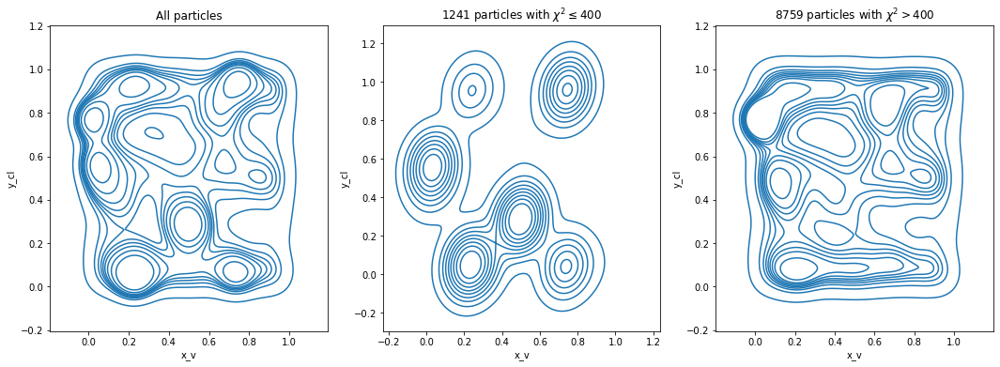

In [31]:
#collapse-hide
import seaborn as sns

xaxis = "x_v"
yaxis = "y_cl"
limit = 400
n_low = (result["chi_2"]<=limit).sum()
n_high = (result["chi_2"]>limit).sum()

fig, ax = plt.subplots(1,3,figsize=(18,6))

sns.kdeplot(ax=ax[0], x=all_df[xaxis], y=all_df[yaxis],)
ax[0].set_title("All particles")

sns.kdeplot(ax=ax[1], x=all_df[xaxis][result["chi_2"]<=limit], y=all_df[yaxis][result["chi_2"]<=limit],)
ax[1].set_title(f"{n_low} particles with $\\chi^2 \\leq {limit}$")

sns.kdeplot(ax=ax[2], x=all_df[xaxis][result["chi_2"]>limit], y=all_df[yaxis][result["chi_2"]>limit],)
ax[2].set_title(f"{n_high} particles with $\\chi^2 > {limit}$")

plt.show()

As we can see, the particles with higher $\chi^2$ values are not as tightly clustered as those with low $\chi^2$ values, and are therefore it's less likely that their swarms are stuck in deep minima. Reassuringly, there seem to be peaks in the densities at approximately the same coordinates as we see in the low $\chi^2$ distribution, which suggests that if we were to leave *GALLOP* running for longer, we'd be in with a good chance of obtaining more solutions.

## Conclusions

In this post, we've been over how to use the *GALLOP* Python API to solve the crystal structure of verapamil hydrochloride, and done some preliminary exploration of the results.

In future posts, we'll look at more advanced methods of using the Python API and spend a bit more time diving into the results.